## Vehicle Detection
---
### Goals & Objectives

The goals / steps of this project are the following:

- Perform a Histogram of Oriented Gradients (HOG) feature extraction on a labeled training set of images and train a Linear SVM classifier
- Apply a color transform and append binned color features, as well as histograms of color, to your HOG feature vector.
- Normalize your features and randomize a selection for training and testing.
- Implement a sliding-window technique and use your trained classifier to search for vehicles in images.
- Run your pipeline on a video stream (start with the test_video.mp4 and later implement on full project_video.mp4) and create a heat map of recurring detections frame by frame to reject outliers and follow detected vehicles.
- Estimate a bounding box for vehicles detected.
---

In [0]:
import numpy as np
import pickle
import cv2
from skimage.feature import hog
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import glob
import time
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.ndimage.measurements import label
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [0]:
# utils.py
import numpy as np
import cv2
from skimage.feature import hog
from scipy.ndimage.measurements import label
import matplotlib.pyplot as plt

## Image Feature Extractor 
class ImgFeatExtract(object):
    """
    Extract features from images using:
     - Histogram of Oriented Gradients (HOG)
     - Spatial Binning
     - Colour Histogram
    Credit to: https://github.com/js1972/CarND-Vehicle-Detection
    """
    def __init__(self, config):
        self.config = config
        
    def feat_extract(self, image):
        """
        Extract features from an image.
        
        :param image: Image array (i.e. mpimg.imread())
        :return: Extracted features as one long feature vector
        """
        # Create a list to append feature vectors to
        features = []
        test_image = []
        
        if np.max(image) > 1:
            image = image.astype(np.float32) / float(np.max(image))
        
        # apply color conversion if other than 'RGB'
        if self.config['color_space'] != 'RGB':
            if self.config['color_space'] == 'HSV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif self.config['color_space'] == 'LUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif self.config['color_space'] == 'HLS':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif self.config['color_space'] == 'YUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
            elif self.config['color_space'] == 'YCrCb':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        else:
            feature_image = np.copy(image)
        
        if self.config['spatial_feat'] == True:
            spatial_features = self.bin_spatial(feature_image)
            features.append(spatial_features)
            
        if self.config['hist_feat'] == True:
            # Apply color_hist()
            hist_features = self.color_hist(feature_image)
            features.append(hist_features)
        
        if self.config['hog_feat'] == True:
            if self.config['hog_channel'] == 'ALL':
                hog_features = []
                for channel in range(feature_image.shape[2]):
                    hog_feature = self.get_hog_feat(feature_image[:, :, channel])
                    hog_features.append(hog_feature)
                                                        
                hog_features = np.ravel(hog_features)
            else:
                hog_features = self.get_hog_feat(feature_image[:, :, hog_channel])
            
            # Append the new feature vector to the features list
            features.append(hog_features)
        
        # Return list of feature vectors
        return np.concatenate(features)
    
    def get_hog_feat_img(self, image, channel):
        """
        Extract HOG features of an image and specific colour channel
        and return the HOG features as an image.
        
        :param image: Image to extract HOG features
        :param channel: Whcih image colour channel to use (0, 1 or 2)
        :return: Image of HOG features visualised
        """
        if np.max(image) > 1:
            image = image.astype(np.float32) / float(np.max(image))
        
        _, hog_image = self.get_hog_feat(image[:, :, channel], True)
        return hog_image
        
    def bin_spatial(self, img):
        size = self.config['spatial_size']
        color1 = cv2.resize(img[:,:,0], size).ravel()
        color2 = cv2.resize(img[:,:,1], size).ravel()
        color3 = cv2.resize(img[:,:,2], size).ravel()
        return np.hstack((color1, color2, color3))
    
    def color_hist(self, img):
        nbins = self.config['hist_bins'] #bins_range=(0, 256)
        # Compute the histogram of the color channels separately
        channel1_hist = np.histogram(img[:,:,0], bins=nbins)
        channel2_hist = np.histogram(img[:,:,1], bins=nbins)
        channel3_hist = np.histogram(img[:,:,2], bins=nbins)
        # Concatenate the histograms into a single feature vector
        hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
        # Return the individual histograms, bin_centers and feature vector
        return hist_features
    
    def get_hog_feat(self, image, visualise=False):
        if visualise == True:
            features, image = hog(image,
                       orientations=self.config['orient'], 
                       pixels_per_cell=(self.config['pix_per_cell'], self.config['pix_per_cell']),
                       cells_per_block=(self.config['cell_per_block'], self.config['cell_per_block']), 
                       transform_sqrt=False, 
                       visualise=True,
                       feature_vector=True)
        
            return features, image
        else:
            features = hog(image,
                       orientations=self.config['orient'], 
                       pixels_per_cell=(self.config['pix_per_cell'], self.config['pix_per_cell']),
                       cells_per_block=(self.config['cell_per_block'], self.config['cell_per_block']), 
                       transform_sqrt=False, 
                       visualise=False,
                       feature_vector=True)
        
            return features


############################################################################

## Object Detector

class ObjDetect(object):
    """
    Detect objects in an image using the provided image
    feature extractor and a trained Linear SVM classifier.
    Credit to: https://github.com/js1972/CarND-Vehicle-Detection
    """
    def __init__(self, config, sliding_window_config, classifier, standard_scaler):
        self.config = config
        self.sliding_window_config = sliding_window_config
        self.classifier = classifier
        self.standard_scaler = standard_scaler
        #self.heatmap = []
        #self.windows = []
        
    def process(self, image):
        """
        Process the image and detect objects.
        
        :param image: Image to detect objects in
        :return: Output image with detected bounding boxes
        """
        global heat
        global windows
        
        draw_image = np.copy(image)
        original_image = np.copy(image)
        
        if np.max(image) > 1:
            image = image.astype(np.float32) / float(np.max(image))
        
        windows = self.get_pyramid_windows(image)
        positive_detections = self.find_objects(image, windows)
        # new heatmap
        heat = np.zeros_like(draw_image[:, :, 0]).astype(np.float)
        heatmap = self.add_heat(heat, positive_detections)
        heatmap = self.threshold_heatmap(heatmap, self.sliding_window_config['heat_threshold'])
        # Blob extraction
        # Implements: https://en.wikipedia.org/wiki/Connected-component_labeling
        labels = label(heatmap)
        output_image = self.draw_labeled_bboxes(original_image, labels)
        return output_image

    def process_and_display(self, image):
        """
        Process the image, detect objects, and display it with the windows.
        """
        global heat
        global windows
        
        draw_image = np.copy(image)
        original_image = np.copy(image)
        
        if np.max(image) > 1:
            image = image.astype(np.float32) / float(np.max(image))
        
        windows = self.get_pyramid_windows(image)
        positive_detections = self.find_objects(image, windows)
        window_img = self.draw_boxes(draw_image, positive_detections, color=(0, 25, 255), thick=6)

        # new heatmap
        heat = np.zeros_like(draw_image[:, :, 0]).astype(np.float)
        heatmap = self.add_heat(heat, positive_detections)
        heatmap = self.threshold_heatmap(heatmap, self.sliding_window_config['heat_threshold'])
        # Blob extraction
        labels = label(heatmap)
        output_image = self.draw_labeled_bboxes(original_image, labels)
        #return output_image

        # Display test images with detected object bounding boxes and heatmaps
        f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20,10))
        ax1.imshow(window_img)
        ax1.set_title('Found bounding boxes', fontsize=10)
        ax1.axis('off')
        
        ax2.imshow(labels[0], cmap='hot')
        ax2.set_title('Blob extraction {} objects'.format(labels[1]), fontsize=10)
        ax2.axis('off')
        
        ax3.imshow(heatmap, cmap='hot')
        ax3.set_title('Heatmap as an image', fontsize=10)
        ax3.axis('off')
        
        ax4.imshow(output_image)
        ax4.set_title('Heatmap converted to bounding box')
        ax4.axis('off')

    
    def find_objects(self, img, windows):
        """
        Loop though all the provided windows and resize the part of the image occupied
        by the window to 64 x 64 to match the size of our test data image.
        With each resized part of the image: extract features and classify.
        
        :param img: Image to process with sliding windows
        :param windows: List of windows to use for object detections
        :return: List of windows with positive object detections.
        """
        # Define a function you will pass an image
        # and the list of windows to be searched (output of slide_windows())
        found_windows = []
        for window in windows:
            test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))
            features = ImgFeatExtract(self.config).feat_extract(test_img)
            test_features = self.standard_scaler.transform(np.array(features).reshape(1, -1))
            prediction = self.classifier.predict(test_features)
            if prediction == 1:
                found_windows.append(window)
            
        return found_windows
    
    def get_pyramid_windows(self, image):
        """
        Repeatedly get sliding windows for different window sizes.
        This will allow our detector to find smaller and larger sized
        objects.
        
        :param image: The image to get multi-scale sliding windows on
        :return: List of windows to check for object detections.
        """
        windows = []
        for xy in self.sliding_window_config['window_sizes']:
            window = self.get_sliding_windows(image, xy_window=(xy, xy))
            windows += window
        return windows
    
    # Define a function that takes an image,
    # start and stop positions in both x and y,
    # window size (x and y dimensions),
    # and overlap fraction (for both x and y)
    def get_sliding_windows(self, img, xy_window):
        """
        Implementation of the sliding-window technique.
        Return a list of windows (rectangles) that have been moved over
        the image with the given size and configured overlap and start/stop
        positions.
        
        :param img: Image to retrieve sliding windows for
        :param xy_window: This is the scale to zoom in on given as a number of pixels
        and used for both widht and height.
        """
        # If x and/or y start/stop positions not defined, set to image size
        if self.sliding_window_config['x_start_stop'][0] == None:
            self.sliding_window_config['x_start_stop'][0] = 0
        if self.sliding_window_config['x_start_stop'][1] == None:
            self.sliding_window_config['x_start_stop'][1] = img.shape[1]
        if self.sliding_window_config['y_start_stop'][0] == None:
            self.sliding_window_config['y_start_stop'][0] = 0
        if self.sliding_window_config['y_start_stop'][1] == None:
            self.sliding_window_config['y_start_stop'][1] = img.shape[0]
    
        xspan = self.sliding_window_config['x_start_stop'][1] - self.sliding_window_config['x_start_stop'][0]
        yspan = self.sliding_window_config['y_start_stop'][1] - self.sliding_window_config['y_start_stop'][0]
        nx_pix_per_step = np.int(xy_window[0] * (1 - self.sliding_window_config['xy_overlap'][0]))
        ny_pix_per_step = np.int(xy_window[1] * (1 - self.sliding_window_config['xy_overlap'][1]))
        nx_windows = np.int(xspan / nx_pix_per_step) - 1
        ny_windows = np.int(yspan / ny_pix_per_step) - 1
        window_list = []
        for ys in range(ny_windows):
            for xs in range(nx_windows):
                # Calculate window position
                startx = xs * nx_pix_per_step + self.sliding_window_config['x_start_stop'][0]
                endx = startx + xy_window[0]
                starty = ys * ny_pix_per_step + self.sliding_window_config['y_start_stop'][0]
                endy = starty + xy_window[1]
                window_list.append(((startx, starty), (endx, endy)))
        return window_list
    
    def draw_boxes(self, img, bboxes, color=(0, 25, 255), thick=6):
        """
        Draw the given bounding boxes on the image
        """
        imcopy = np.copy(img)
        for bbox in bboxes:
            cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
        return imcopy
    
    def add_heat(self, heatmap, bbox_list):
        """
        Build up a heat map image from the given bounding
        boxes. We add +1 for each pixel within the bounding 
        box.
        """
        #heat = np.zeros_like(draw_image[:, :, 0]).astype(np.float) ## ??
        for box in bbox_list:
            heat[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1
        return heatmap
    
    def threshold_heatmap(self, heatmap, threshold=1):
        """
        Zero out pixels in the provided image below the given threshold
        
        :param heatmap: Heatmap array - same size as image
        :param threshold: The threhold value below which pixes are zeroed
        :return: Extracted features as one long feature vector
        """
        heatmap[heatmap <= threshold] = 0
        return heatmap
    
    def draw_labeled_bboxes(self, img, labels):
        """
        """
        # Iterate through all detected cars
        for car_number in range(1, labels[1]+1):
            # Find pixels with each car_number label value
            nonzero = (labels[0] == car_number).nonzero()
            # Identify x and y values of those pixels
            nonzeroy = np.array(nonzero[0])
            nonzerox = np.array(nonzero[1])
            # Define a bounding box based on min/max x and y
            bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
            # Draw the box on the image
            cv2.rectangle(img, bbox[0], bbox[1], (0, 25, 255), 6)
        # Return the image
        return img

In [0]:
#from utils.utils import ImgFeatExtract
# autoreload plugin
# this will automatically update the imported modules with the changes made on the fly in the functions.py script
%load_ext autoreload
%autoreload 2

Download data

In [0]:
!pwd

In [0]:
!wget https://s3.amazonaws.com/udacity-sdc/Vehicle_Tracking/vehicles.zip && unzip vehicles.zip

In [0]:
!wget https://s3.amazonaws.com/udacity-sdc/Vehicle_Tracking/non-vehicles.zip && unzip non-vehicles.zip

## 1. Feature Extraction - Histogram of Oriented Gradients (HOG)
Please refer to the utils/utils.py file that contains `ImgFeatExtract` class and the functions that perform the feature extraction. 

This is the final configuration chosen to instantiate `ImgFeatExtract` class after performing a parameter fine-tuning. 

In [0]:
feature_config = {
    'color_space' : 'YCrCb',  # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
    'orient' : 12,
    'pix_per_cell' : 8,
    'cell_per_block' : 2,
    'hog_channel' : 'ALL',
    'spatial_size' : (32, 32), # Spatial binning dimensions
    'hist_bins' : 32,
    'spatial_feat' : True,
    'hist_feat' : True,
    'hog_feat' : True
}

Test the `ImgFeaExtractor` in a random image from my vehicles dataset. 

([], <a list of 0 Text yticklabel objects>)

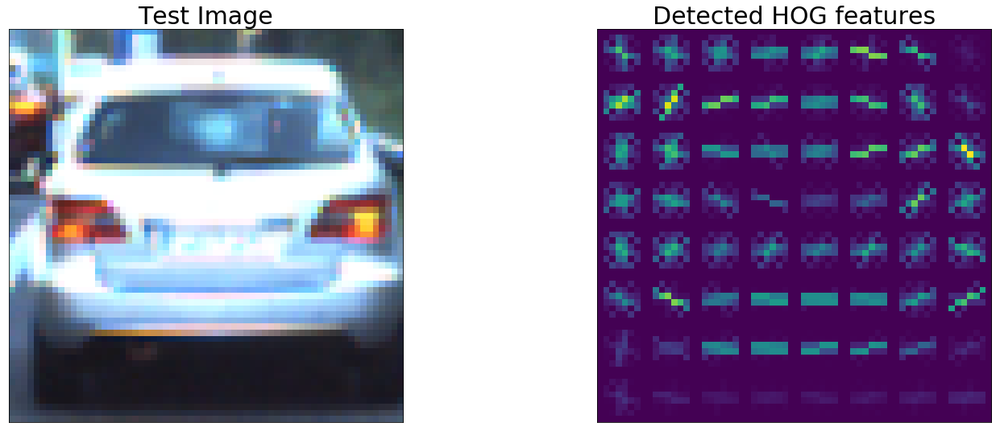

In [7]:
test_image = mpimg.imread('/content/vehicles/KITTI_extracted/31.png')
ife = ImgFeatExtract(feature_config)
hog_img = ife.get_hog_feat_img(test_image, 0)
del ife

plt.figure(figsize=(8, 3))
plt.subplot(121)
plt.imshow(test_image)
plt.title('Test Image',fontsize=30)
plt.xticks([])
plt.yticks([])

plt.subplot(122)
plt.imshow(hog_img)
plt.title('Detected HOG features',fontsize=30)
plt.xticks([])
plt.yticks([])

## 2. Training the classifier

A Linear SVM was chosen as my classifier. SVC provides relatively high accuracy and fast computation, which makes it a good fit for this type of job. 
Here are the steps followed to train the classifier:
1. Read all the positive images (with cars)
2. Read all the negative images (without cars)
3. Instantiate my feature extractor `ImageFeatureExtractor` with the chosen configuration.
4. Stack the feature vectors (HOG, Spatial, Color Histogram) together and create the labels. 
5. Split data into train and test, 70-30. 
6. Instantiate a `LinearSVC` , fit it to the features and test its accuracy. 

Please refer to the utils/utils.py file that contains `train()` function that performs the steps mentioned above using the feature configuration preselected. 

In [10]:
!mkdir model
!ls

__MACOSX  models	non-vehicles.zip  vehicles
model	  non-vehicles	sample_data	  vehicles.zip


In [0]:
def train(feat_config):
    print('Extracting features...')

    t = time.time()
    ife = ImgFeatExtract(feat_config)

    # Divide up into cars and notcars
    cars = glob.glob('/content/vehicles/*/*.png')
    notcars = glob.glob('/content/non-vehicles/*/*.png')

    car_features = []
    notcar_features = []

    for file in cars:
        image = mpimg.imread(file)
        car_feature = ife.feat_extract(image)
        car_features.append(car_feature)

    for file in notcars:
        image = mpimg.imread(file)
        notcar_feature = ife.feat_extract(image)
        notcar_features.append(notcar_feature)

    t2 = time.time()
    print(round(t2 - t, 2), 'Seconds to extract features...')

    # Create an array stack of feature vectors
    X = np.vstack((car_features, notcar_features)).astype(np.float64)
    # Fit a per-column scaler
    X_scaler = StandardScaler().fit(X)
    # Apply the scaler to X
    scaled_X = X_scaler.transform(X)

    # Define the labels vector
    y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))

    # Split up data into randomized training and test sets
    rand_state = np.random.randint(0, 100)
    X_train, X_test, y_train, y_test = train_test_split(
        scaled_X, y, test_size=0.3, random_state=rand_state)

    print('Using:', feature_config['orient'], 'orientations', feature_config['pix_per_cell'],
          'pixels per cell and', feature_config['cell_per_block'], 'cells per block')
    print('Feature vector length:', len(X_train[0]))

    # Use a linear SVC
    print('\nTraining classifier...')
    svc = LinearSVC()
    # Check the training time for the SVC
    t = time.time()
    svc.fit(X_train, y_train)
    t2 = time.time()
    print(round(t2 - t, 2), 'Seconds to train SVC...')

    # Check the score of the SVC
    print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4))

    # Pickle results
    with open('/content/model/model.pkl', 'wb') as f:
        pickle.dump(svc, f)

    with open('/content/model/xscaler.pkl', 'wb') as f:
        pickle.dump(X_scaler, f)
    return svc, X_scaler


In [9]:
svc, X_scaler = train(feature_config)

Extracting features...
121.62 Seconds to extract features...
Using: 12 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 10224

Training classifier...
14.02 Seconds to train SVC...
Test Accuracy of SVC =  0.9912


Without tuning the hyperparameters of the LinearSVM and simply using the ones that come by default, we achieve an accuracy of 99.36%, which is pretty good for the model. 

## 3. Sliding Window Search
This is the combination of parameters chosen for my sliding window configuration. This combination was chosen after performing parameter fine-tuning in a way that minimize the number of False Positive cases.

Please refer to the utils/utils.py file that contains `ObjDetect` class and the function that scans images to detect vehicles. This algorithm is implemented in 2-steps: perform the images processing and object detection. 

The `process_and_display()` function has the following steps:
- Pyramid search or Scale search: We slide the windows across the image at different scales. This is good to detect objects in varying sizes, like cars driving on the road that are at different distances from me. This method is applied using `get_sliding_windows` in  `process_and_display` of class ObjDetect. 
- This method in-turn calls method `get_sliding_windows` passing it a different scale (or image size) on each iteration. `get_sliding_windows` returns an array of window points (rectangles). 

In [0]:
sliding_windows_config = {
    'xy_overlap' : (0.75, 0.8),
    'xy_window' : [64, 64],
    'y_start_stop' : [320, 680],
    'x_start_stop' : [760, 1260],
    'window_sizes' : [60, 100, 150],
    'heat_threshold' : 2
}

In [0]:
# Create Test Images:
!mkdir test_images 
!wget -P /content/test_images https://github.com/ilopezfr/Self-Driving-Car-Engineering/raw/master/CarND-P05-Vehicle-Detection/test_images/test1.jpg
!wget -P /content/test_images https://github.com/ilopezfr/Self-Driving-Car-Engineering/raw/master/CarND-P05-Vehicle-Detection/test_images/test2.jpg 
!wget -P /content/test_images https://github.com/ilopezfr/Self-Driving-Car-Engineering/raw/master/CarND-P05-Vehicle-Detection/test_images/test3.jpg
!wget -P /content/test_images https://github.com/ilopezfr/Self-Driving-Car-Engineering/raw/master/CarND-P05-Vehicle-Detection/test_images/test4.jpg  
!wget -P /content/test_images https://github.com/ilopezfr/Self-Driving-Car-Engineering/raw/master/CarND-P05-Vehicle-Detection/test_images/test5.jpg

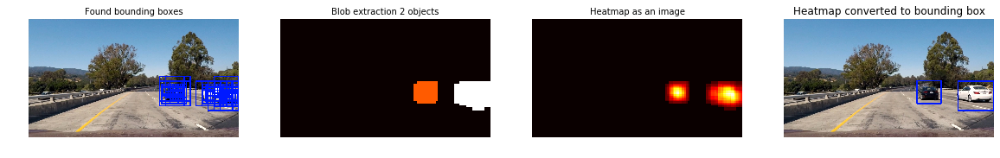

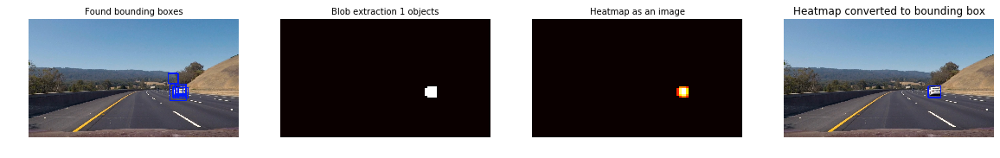

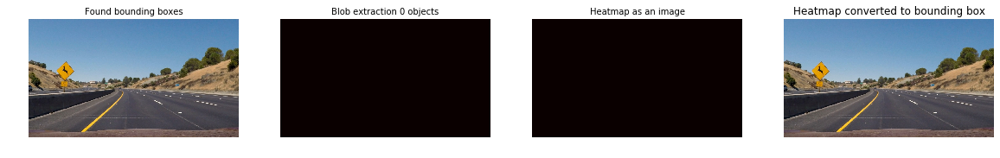

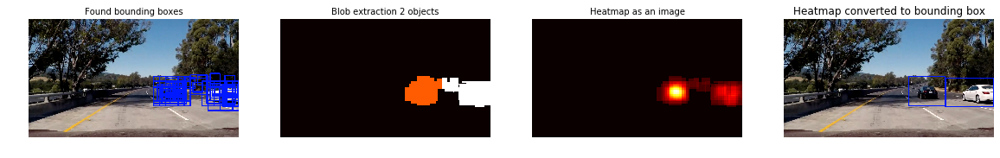

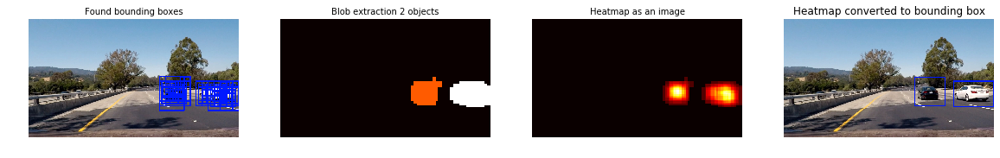

In [23]:
#from utils.utils import ObjDetect
glob_test_images = glob.glob('/content/test_images/*.jpg')
detector = ObjDetect(feature_config, sliding_windows_config, svc, X_scaler)

for file in glob_test_images:
    image = mpimg.imread(file)
    detector.process_and_display(image)

### Test the pipeline on the test images
Here we test the pipeline calling `process()` function of class `ObjDetect` on the test images. As we can see, the detector does a good job identifying and framing the vehicles on the road. 

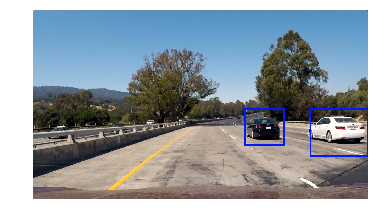

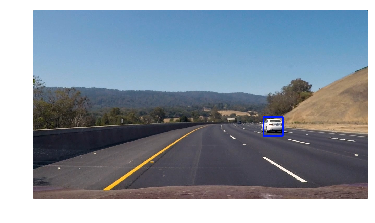

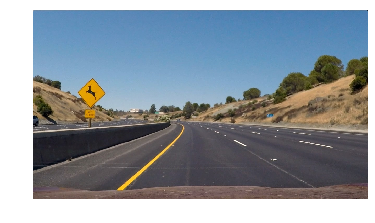

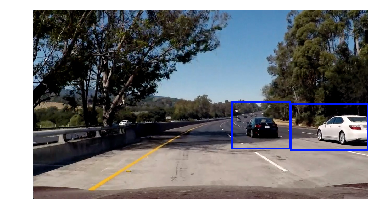

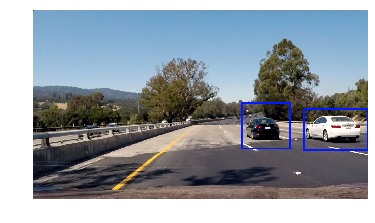

In [24]:
glob_test_images = glob.glob('/content/test_images/*.jpg')
del detector
detector = ObjDetect(feature_config, sliding_windows_config, svc, X_scaler)

for file in glob_test_images:
    image = mpimg.imread(file)
    plt.imshow(detector.process(image))
    plt.axis('off')
    plt.show()

## 4. Video Implementation

### Test video

In [26]:
!wget https://github.com/ilopezfr/Self-Driving-Car-Engineering/raw/master/CarND-P05-Vehicle-Detection/test_video.mp4

--2019-08-06 22:24:33--  https://github.com/ilopezfr/Self-Driving-Car-Engineering/raw/master/CarND-P05-Vehicle-Detection/test_video.mp4
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/ilopezfr/Self-Driving-Car-Engineering/master/CarND-P05-Vehicle-Detection/test_video.mp4 [following]
--2019-08-06 22:24:33--  https://raw.githubusercontent.com/ilopezfr/Self-Driving-Car-Engineering/master/CarND-P05-Vehicle-Detection/test_video.mp4
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 801181 (782K) [application/octet-stream]
Saving to: ‘test_video.mp4’

test_video.mp4      100%[===================>] 782.40K  --

In [29]:
video_output = '/content/test_video_output.mp4'
#clip1 = VideoFileClip('project_video.mp4')
clip1 = VideoFileClip('/content/test_video.mp4')
clip1_output = clip1.fl_image(detector.process) #NOTE: this function expects color images!!
%time clip1_output.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video /content/test_video_output.mp4
[MoviePy] Writing video /content/test_video_output.mp4



 97%|█████████▋| 38/39 [07:53<00:12, 12.50s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: /content/test_video_output.mp4 

CPU times: user 9min 38s, sys: 5min 57s, total: 15min 35s
Wall time: 7min 56s


In [49]:
import io
import base64
from IPython.display import HTML

video = io.open("/content/test_video_output.mp4", 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" autoplay 
                loop controls controls style="height: 400px;" >
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

### Project Video

In [0]:
!wget https://github.com/ilopezfr/Self-Driving-Car-Engineering/raw/master/CarND-P05-Vehicle-Detection/project_video.mp4

In [0]:
video_output = '/content/project_video_output.mp4'
#clip1 = VideoFileClip('project_video.mp4')
clip1 = VideoFileClip('/content/project_video.mp4')
clip1_output = clip1.fl_image(detector.process) #NOTE: this function expects color images!!
%time clip1_output.write_videofile(video_output, audio=False)

In [51]:
video = io.open("/content/project_video_output.mp4", 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" autoplay 
                loop controls controls style="height: 400px;" >
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))